In [1]:
"""
Prediction file: Based on the trained neural network,see the performace on the testing set
Mapping Seed->Sim 

Here we are seeing the data demand requirement with changing training data size and observing the performance of the network 

General workflow
Load test data->Load multiple dilResNet models(trained with different number of images)and predict the output(are in latent representation) on test set-> 
Decode into higher dimensional representation using SD VAE-> Display 

"""

'\nPrediction file: Based on the trained neural network,see the performace on the testing set\nMapping Seed->Sim \n\nHere we are seeing the data demand requirement with changing training data size and observing the performance of the network \n\nGeneral workflow\nLoad test data->Load multiple dilResNet models(trained with different number of images)and predict the output(are in latent representation) on test set-> \nDecode into higher dimensional representation using SD VAE-> Display \n\n'

In [17]:
# import libs 
import os
import torch
import torch.nn as nn
import cv2
import numpy as np
import matplotlib.pyplot as plt
from diffusers import AutoencoderKL
from PIL import Image
import re
import pickle

In [12]:
# prediction from testing dataset

'''
Loading test data for model testing

'''


rfactor=256
img_length=rfactor
img_width=rfactor

# for CentOS 8 cluster 
datadir_i='/hpc/group/youlab/ks723/storage/MATLAB_SIMS/Sim_050924/Sim_input/intermediate/Tp3'
datadir_o="/hpc/group/youlab/ks723/storage/MATLAB_SIMS/Sim_050924/Sim_input/complex/Tp3"

path_i=os.path.join(datadir_i)
path_o=os.path.join(datadir_o)

ground_truth_data=[]
input_data=[]

# parameters for image

img_shape_i=256  # to make image 256x256 after cropping the image
img_shape_o=256  # to make image 32x32 after cropping the image 


# parameters for cropping output of sim hardcoded
top_crop_i = 30
bottom_crop_i = 30
left_crop_i = 31
right_crop_i = 30

def create_ground_truth_data(top_crop, bottom_crop, left_crop, right_crop, start_index, end_index):
    count = 0
    img_filenames_i = sorted(os.listdir(path_i))

    # Ensure end_index does not exceed the number of available images
    end_index = min(end_index, len(img_filenames_i))

    for img in img_filenames_i[start_index:end_index]:
        img_array_i = cv2.imread(os.path.join(path_i, img), cv2.IMREAD_GRAYSCALE)

        new_height = img_array_i.shape[0] - (top_crop + bottom_crop)
        new_width = img_array_i.shape[1] - (left_crop + right_crop)

        new_array_i = img_array_i[top_crop:top_crop + new_height, left_crop:left_crop + new_width]
        new_array_i = cv2.resize(new_array_i, (img_length, img_width))

        ground_truth_data.append([new_array_i])
        count = count + 1
        if count >= (end_index - start_index):
            break


# note the indexes of these images are far ahead from the ones we used in training, so they can serve as test set images

start_index = 70000  
end_index = 70100  

create_ground_truth_data(top_crop_i, bottom_crop_i, left_crop_i, right_crop_i, start_index, end_index)


top_crop_o=30
bottom_crop_o=30
left_crop_o=31
right_crop_o=30

def create_input_data(top_crop,bottom_crop,left_crop,right_crop, start_index, end_index):
    
    count = 0
    img_filenames_o = sorted(os.listdir(path_o))

    # Ensure end_index does not exceed the number of available images
    end_index = min(end_index, len(img_filenames_o))

    for img in img_filenames_o[start_index:end_index]:
        img_array_o = cv2.imread(os.path.join(path_o, img), cv2.IMREAD_GRAYSCALE)

        new_height = img_array_o.shape[0] - (top_crop + bottom_crop)
        new_width = img_array_o.shape[1] - (left_crop + right_crop)

        new_array_o = img_array_o[top_crop:top_crop + new_height, left_crop:left_crop + new_width]
        new_array_o = cv2.resize(new_array_o, (img_length, img_width))

        input_data.append([new_array_o])
        count = count + 1
        if count >= (end_index - start_index):
            break

create_input_data(top_crop_o, bottom_crop_o, left_crop_o, right_crop_o, start_index, end_index)


# X is the ground truth output with the final patterns, y is the input data

X=ground_truth_data  
y=input_data

X=(np.array(X).reshape(-1,1,img_shape_i,img_shape_i)) #/255.0  # last one is grayscale first minus one is all x
y=(np.array(y).reshape(-1,1,img_shape_o,img_shape_o)) #/255.0

# normalizing images here to be bw 0 and 1 

X=X/255.0 
y=y/255.0
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")

# Convert numpy arrays to torch tensors
X = torch.Tensor(X)
y = torch.Tensor(y)

y3=y.repeat(1, 3, 1, 1)
y4=y.repeat(1, 4, 1, 1)

In [ ]:
'''
Defining dilResNet model for loading model weights
'''

# Dilated Basic Block similar to PDEArena
class PDEArenaDilatedBlock(nn.Module):
    def __init__(self, in_planes, out_planes, dilation_rates, activation=nn.ReLU, norm=True):
        super(PDEArenaDilatedBlock, self).__init__()

        # Create dilated convolution layers with specified dilation rates
        self.dilated_layers = nn.ModuleList([
            nn.Conv2d(
                in_planes if i == 0 else out_planes, 
                out_planes, 
                kernel_size=3, 
                padding=rate, 
                dilation=rate, 
                bias=False
            )
            for i, rate in enumerate(dilation_rates)
        ])
        
        # Normalization and Activation layers
        self.norm_layers = nn.ModuleList([nn.BatchNorm2d(out_planes) if norm else nn.Identity() for _ in dilation_rates])
        self.activation = activation(inplace=True)

        # Shortcut (1x1 convolution if input and output planes differ)
        self.shortcut = nn.Sequential()
        if in_planes != out_planes:
            self.shortcut = nn.Sequential(
                nn.Conv2d(in_planes, out_planes, kernel_size=1, bias=False),
                nn.BatchNorm2d(out_planes) if norm else nn.Identity()
            )

    def forward(self, x):
        out = x
        for layer, norm in zip(self.dilated_layers, self.norm_layers):
            out = self.activation(norm(layer(out)))
        return out + self.shortcut(x)  # Residual connection

# Dilated ResNet with Adjustable Layers and Blocks
class PDEArenaDilatedResNet(nn.Module):
    def __init__(self, in_channels, out_channels, hidden_channels=64, num_blocks=15, dilation_rates=[1, 2, 4, 8], activation=nn.ReLU, norm=True):
        super(PDEArenaDilatedResNet, self).__init__()
        
        self.in_conv = nn.Conv2d(in_channels, hidden_channels, kernel_size=3, padding=1)  # Input layer
        
        # Stack of dilated blocks
        self.layers = nn.Sequential(
            *[PDEArenaDilatedBlock(hidden_channels, hidden_channels, dilation_rates, activation=activation, norm=norm) for _ in range(num_blocks)]
        )
        
        self.out_conv = nn.Conv2d(hidden_channels, out_channels, kernel_size=3, padding=1)  # Output layer

    def forward(self, x):
        x = self.in_conv(x)
        x = self.layers(x)
        return self.out_conv(x)

# Example usage
model = PDEArenaDilatedResNet(
    in_channels=4,               # Input channels 
    out_channels=4,              # Output channels 
    hidden_channels=64,          # Number of hidden channels
    num_blocks=18,               # Number of dilated blocks 
    dilation_rates=[1, 2, 4, 8], # Dilation rates for multi-scale feature capture
    activation=nn.ReLU,          # Activation function
    norm=True
)


In [ ]:
'''
Define pre-trained SD VAE for decoding orginal predicted patterns from the latent predicted patterns
dilResnet will predict latent representation of patterns 

'''


device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")

# first load the VAE

vae = AutoencoderKL.from_pretrained("CompVis/stable-diffusion-v1-4", subfolder="vae")

vae.to(device)


def encode_img(input_img):
    input_img = input_img.repeat(3, 1, 1)
    
    # Single image -> single latent in a batch (so size 1, 4, 64, 64)
    if len(input_img.shape)<4:
        input_img = input_img.unsqueeze(0)
    with torch.no_grad():
        latent = vae.encode(input_img*2 - 1) # Note scaling  # to make outputs from -1 to 1 
    return 0.18215 * latent.latent_dist.sample()


def decode_img(latents):
    # bath of latents -> list of images
    latents = (1 / 0.18215) * latents
    with torch.no_grad():
        image = vae.decode(latents).sample
    image = (image / 2 + 0.5).clamp(0, 1)    # to make outputs from 0 to 1 
    image = image.detach()
    return image

pickle_in=open("/hpc/group/youlab/ks723/miniconda3/Lingchong/Latents/latent_dim_75000_4channels_4x32x32_newintermediate102.pickle","rb")
yprime_in=pickle.load(pickle_in)

yprime_in=yprime_in[start_index:end_index,:,:,:]

yprime_in = torch.Tensor(yprime_in)




/hpc/dctrl/ks723/miniconda3/envs/test_pytorch_ipy_v2/lib/python3.10/site-packages/huggingface_hub/file_download.py:1142: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


Sorted filenames:
['Pixel_32x32x3to32x32x4_dilRESNET_newpatterns_intermediatetocomplex_100_Test_Model_v314_Cluster_GPU_tfData-1741970550.pt', 'Pixel_32x32x3to32x32x4_dilRESNET_newpatterns_intermediatetocomplex_200_Test_Model_v314_Cluster_GPU_tfData-1741970454.pt', 'Pixel_32x32x3to32x32x4_dilRESNET_newpatterns_intermediatetocomplex_400_Test_Model_v314_Cluster_GPU_tfData-1741970540.pt', 'Pixel_32x32x3to32x32x4_dilRESNET_newpatterns_intermediatetocomplex_800_Test_Model_v314_Cluster_GPU_tfData-1741970615.pt', 'Pixel_32x32x3to32x32x4_dilRESNET_newpatterns_intermediatetocomplex_1600_Test_Model_v314_Cluster_GPU_tfData-1741970770.pt', 'Pixel_32x32x3to32x32x4_dilRESNET_newpatterns_intermediatetocomplex_3200_Test_Model_v314_Cluster_GPU_tfData-1741971307.pt', 'Pixel_32x32x3to32x32x4_dilRESNET_newpatterns_intermediatetocomplex_6400_Test_Model_v314_Cluster_GPU_tfData-1741971977.pt', 'Pixel_32x32x3to32x32x4_dilRESNET_newpatterns_intermediatetocomplex_12800_Test_Model_v314_Cluster_GPU_tfData-17419743

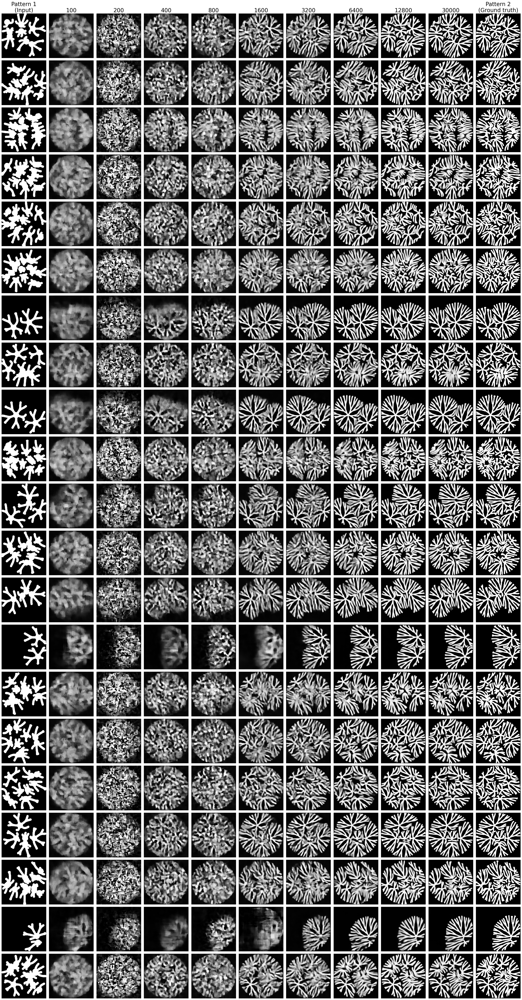

In [20]:
'''
Functions for selecting the appropriate ResNet and displaying their decoded predictions in a grid format with multiple samples 
'''

def tensor_to_pil_v2(tensor):
    tensor = tensor.permute(1,2,0)  # Convert to  (height, width, channels)
    return [Image.fromarray((img.numpy() * 255).astype('uint8')) for img in tensor]


def display_predictions_multiple_samples(input_images, ground_truths, pred_images_list, num_samples_list):
    num_models = len(pred_images_list)
    num_samples = len(input_images)
    total_images = num_models + 2  # Input image + predictions + ground truth

    # Create subplots: num_samples rows, total_images columns
    fig, axes = plt.subplots(num_samples, total_images, figsize=(total_images * 3, num_samples * 3))

    for s in range(num_samples):
        # Display the input image in the first subplot of the row
        if num_samples == 1:
            ax = axes[0]
        else:
            ax = axes[s, 0]
        image_i = tensor_to_pil_v2(input_images[s])
        ax.imshow(image_i,cmap='gray')
        ax.axis('off')
       
        if s == 0:
            ax.set_title('Pattern 1\n(Input)', fontsize=25)

        # Display the predicted images in the middle subplots
        for i in range(num_models):
            if num_samples == 1:
                ax = axes[i + 1]
            else:
                ax = axes[s, i + 1]
            image_p = tensor_to_pil_v2(pred_images_list[i][s])

            image_p = np.array(image_p)
            image_p = np.mean(image_p[..., :3], axis=-1) 



            ax.imshow(image_p,cmap='gray',vmin=0, vmax=255)
            ax.axis('off')
            if s == 0:
                ax.set_title(f"{num_samples_list[i]}", fontsize=25)

        # Display the ground truth image in the last subplot of the row
        if num_samples == 1:
            ax = axes[-1]
        else:
            ax = axes[s, -1]
        image_gt = tensor_to_pil_v2(ground_truths[s])
        ax.imshow(image_gt,cmap='gray')
        ax.axis('off')
        if s == 0:
            ax.set_title('Pattern 2\n(Ground truth)', fontsize=25)

    plt.tight_layout()
    plt.show()

# Regular expression pattern to match the filenames
pattern = r"Pixel_32x32x3to32x32x4_dilRESNET_newpatterns_intermediatetocomplex_([\d]+)_Test_Model_v314_.*\.pt"


def extract_number(filename):
    match = re.search(pattern, filename)
    if match:
        return int(match.group(1))  # Extract the number of images
    return float('inf')

# Directory containing the model files
directory = '/hpc/group/youlab/ks723/miniconda3/saved_models/trained/'  # Update this to your models' directory

# List all files and filter out those matching the pattern
filtered_filenames = [filename for filename in os.listdir(directory) if re.match(pattern, filename)]

# Sort the filenames based on the number of images used in training
sorted_filenames = sorted(filtered_filenames, key=extract_number)

print("Sorted filenames:")
print(sorted_filenames)

# Initialize lists to collect predictions and number of samples
pred_images_list = []
num_samples_list = []

# Choose sample indices
sample_indices = list(range(21)) # Adjust as needed 0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20# Choose sample indices


# Get the input images and ground truths for the fixed samples
input_images = X[sample_indices].cpu()  # Ensure tensors are on CPU
ground_truths = y3[sample_indices].cpu()

# Loop through each model file
for filename in sorted_filenames:
    num_samples = extract_number(filename)
    num_samples_list.append(num_samples)
    
    print(f"Processing model trained with {num_samples} samples: {filename}")
    
    # Load the model
    model.load_state_dict(torch.load(os.path.join(directory, filename)))
    model.to(device)
    model.eval()
    
    with torch.no_grad():
        # Make predictions for the selected input images
        predicted_latents = model(yprime_in[sample_indices].to(device))
        # Decode the predictions
        pred_images = decode_img(predicted_latents)
        pred_images_list.append(pred_images.cpu())  # Move to CPU for plotting


'''
Displaying predictions for indices 0 to 20, seeing performance for many seeds
'''

# Call the plotting function
display_predictions_multiple_samples(input_images, ground_truths, pred_images_list, num_samples_list)

Processing model trained with 100 samples: Pixel_32x32x3to32x32x4_dilRESNET_newpatterns_intermediatetocomplex_100_Test_Model_v314_Cluster_GPU_tfData-1741970550.pt
Processing model trained with 200 samples: Pixel_32x32x3to32x32x4_dilRESNET_newpatterns_intermediatetocomplex_200_Test_Model_v314_Cluster_GPU_tfData-1741970454.pt
Processing model trained with 400 samples: Pixel_32x32x3to32x32x4_dilRESNET_newpatterns_intermediatetocomplex_400_Test_Model_v314_Cluster_GPU_tfData-1741970540.pt
Processing model trained with 800 samples: Pixel_32x32x3to32x32x4_dilRESNET_newpatterns_intermediatetocomplex_800_Test_Model_v314_Cluster_GPU_tfData-1741970615.pt
Processing model trained with 1600 samples: Pixel_32x32x3to32x32x4_dilRESNET_newpatterns_intermediatetocomplex_1600_Test_Model_v314_Cluster_GPU_tfData-1741970770.pt
Processing model trained with 3200 samples: Pixel_32x32x3to32x32x4_dilRESNET_newpatterns_intermediatetocomplex_3200_Test_Model_v314_Cluster_GPU_tfData-1741971307.pt
Processing model t

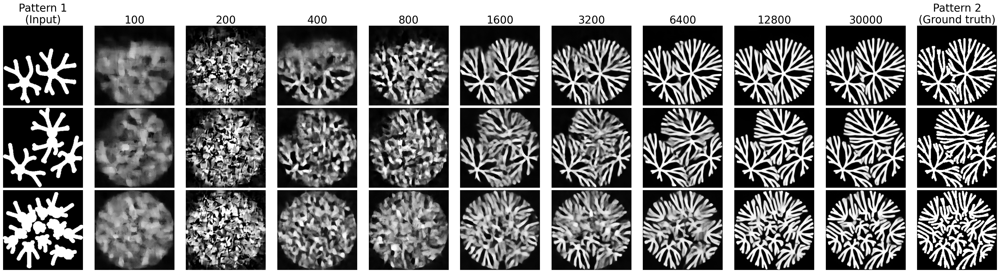

In [23]:
'''
Displaying predictions for indices 5,6,10 with a specific number of seeds(to serve as generalized illustration across whole test set)
'''
# Initialize lists to collect predictions and number of samples
pred_images_list = []
num_samples_list = []



sample_indices = [6,10,5]

# Get the input images and ground truths for the fixed samples
input_images = X[sample_indices].cpu()  # Ensure tensors are on CPU
ground_truths = y3[sample_indices].cpu()

# Loop through each model file
for filename in sorted_filenames:
    num_samples = extract_number(filename)
    num_samples_list.append(num_samples)
    
    print(f"Processing model trained with {num_samples} samples: {filename}")
    
    # Load the model
    model.load_state_dict(torch.load(os.path.join(directory, filename)))
    model.to(device)
    model.eval()
    
    with torch.no_grad():
        # Make predictions for the selected input images
        predicted_latents = model(yprime_in[sample_indices].to(device))
        # Decode the predictions
        pred_images = decode_img(predicted_latents)
        pred_images_list.append(pred_images.cpu())  # Move to CPU for plotting

# Call the plotting function
display_predictions_multiple_samples(input_images, ground_truths, pred_images_list, num_samples_list)